<a href="https://colab.research.google.com/github/Lorddickenstein/FSLRwithNLP/blob/main/Application/Preprocess_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preprocessing Techniques
Contains functions that are used for image preprocessing. Functions exactly like the utils.py in our github repo.

In [2]:
import numpy as np
import os
import cv2
import glob
import warnings
import random
import shutil
import matplotlib.pyplot as plt

warnings.simplefilter(action='ignore', category=FutureWarning)
%matplotlib inline

In [3]:
# Resize Image with default dimension (224, 224)
def resize_image(src_img, height=224, width=224):
    return cv2.resize(src_img, (height, width), interpolation=cv2.INTER_CUBIC)
    

In [4]:
# Show image in matplotlib
def show_plt_image(src_img):
    plt.imshow(src_img)
    plt.show()

In [5]:
# Returns the image in binary using Otsu's binarization
def get_thresh(src_img):
    return cv2.threshold(src_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

In [6]:
# Returns an image with morphological transformation using MORPH_CLOSE
def morph_image(src_img, method=cv2.MORPH_CLOSE, kernel=(5, 5)):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, kernel)
    return cv2.morphologyEx(src_img, method, kernel)

In [7]:
# Get edges using Canny Edge Detection
def get_edges(src_img, th1=150, th2=210):
    return cv2.Canny(src_img, th1, th2)

In [8]:
# Calculate the contours of an image
def get_contours(img, mode=cv2.RETR_EXTERNAL, method=cv2.CHAIN_APPROX_SIMPLE):
    return cv2.findContours(img.copy(), mode, method)

In [9]:
# Returns a new image with bounding rectangle
def get_bounding_rect(src_img, mask):
    pts = np.column_stack(np.where(mask.transpose() > 0))
    x, y, w, h = cv2.boundingRect(pts)
    return cv2.rectangle(src_img, (x, y), (x + w, y + h), (0, 0, 255), 2)

In [168]:
def skin_segmentation(src_img):
    # YCrCb pixel upper and lower boundaries
    YCbCr_lower = np.array([0, 135, 80], np.uint8)
    YCbCr_upper = np.array([255, 180, 135], np.uint8)

    # Convert bgr to YCbCr color space
    img_YCbCr = cv2.cvtColor(src_img, cv2.COLOR_BGR2YCrCb)

    # Determine the intensities of YCbCr pixel intensities that fall inside the upper and lower boundaries
    YCrCb_mask = cv2.inRange(img_YCbCr, YCbCr_lower, YCbCr_upper)

    # Apply open morphological transformation
    YCrCb_mask = morph_image(YCrCb_mask, method=cv2.MORPH_OPEN, kernel=(5, 5))

    # Apply close morphological transformation
    YCrCb_mask = morph_image(YCrCb_mask, method=cv2.MORPH_CLOSE, kernel=(9, 9))

    # Apply Dilation
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (8, 8))
    YCrCb_mask = cv2.dilate(YCrCb_mask, kernel, iterations=1)

    # Blur image to lessen noise
    YCrCb_mask_blur = cv2.medianBlur(YCrCb_mask, 9)

    show_plt_image(YCrCb_mask_blur)

    # Apply mask to the frame
    return cv2.bitwise_and(src_img.copy(), src_img.copy(), mask=YCrCb_mask_blur)

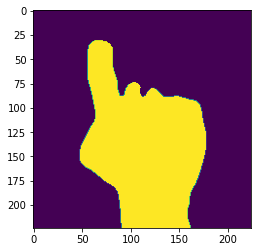

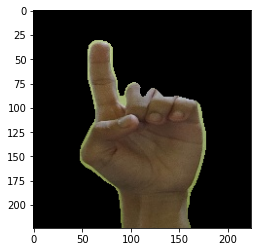

In [171]:
img = cv2.imread('/content/drive/MyDrive/Colab Notebooks/Datasets/OurDataset/Experiments/Dataset_Experiments/Letters/D/D_61.jpg')
skin_mask = skin_segmentation(img)
show_plt_image(cv2.cvtColor(skin_mask, cv2.COLOR_BGR2RGB))

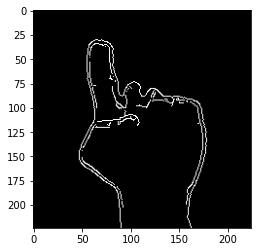

In [172]:
# Canny Edges
edges = get_edges(skin_mask, th1=150, th2=210)
show_plt_image(cv2.cvtColor(edges, cv2.COLOR_BGR2RGB))

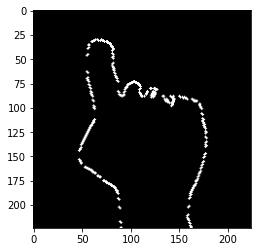

In [173]:
blank = np.zeros(img.shape, dtype='uint8')
contours, hierarchies = get_contours(edges)
cnt = max(contours, key=lambda x: cv2.contourArea(x))
cv2.drawContours(blank, cnt, -1, (255, 255, 255), 2)
show_plt_image(blank)

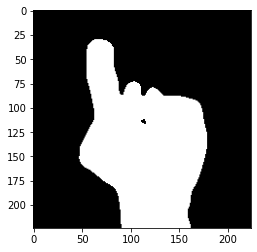

In [182]:
blur_img = cv2.GaussianBlur(cv2.cvtColor(skin_mask, cv2.COLOR_BGR2GRAY), (5, 5), 0)
_, th = cv2.threshold(blur_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
plt.imshow(th, cmap='gray')
plt.show()

# Preprocess Image
Extract hands from the background by using Skin_Segmentation.

Save images to Preprocessed folder.

In [184]:
root = '/content/drive/MyDrive/Colab Notebooks/Datasets/OurDataset/Preprocessed_Raw_Dataset'

letters = ['A', 'B', 'C', 'D', 'E',
           'F', 'G', 'H', 'I', 'J',
           'K', 'L', 'M', 'N', 'O',
           'P', 'Q', 'R', 'S', 'T',
           'U', 'V', 'W', 'X', 'Y',
           'Z']

In [176]:
def make_dir(path, class_obj):
  for obj in class_obj:
    path_class = os.path.join(path, obj)
    os.makedirs(path_class)

In [ ]:
# Make a folder for every classes
dataset_preprocessed = os.path.join(root, 'Letters')
if os.path.isdir(dataset_preprocessed) is False:
  make_dir(dataset_preprocessed, letters)
else:
  print("Directory already exists.")

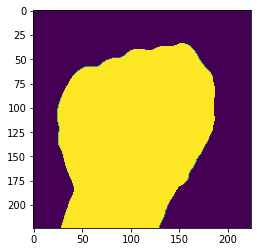

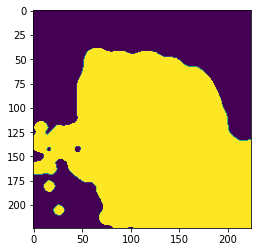

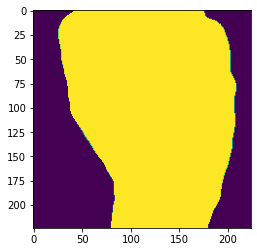

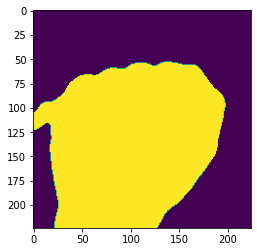

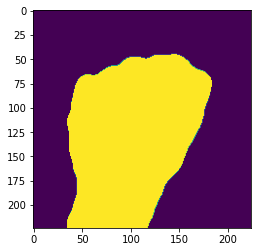

...

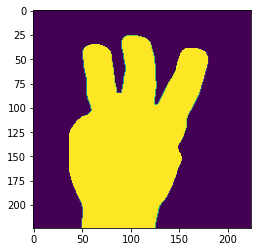

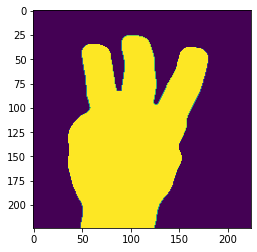

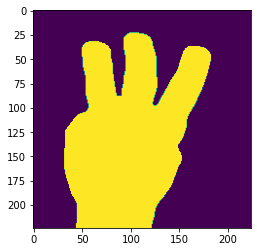

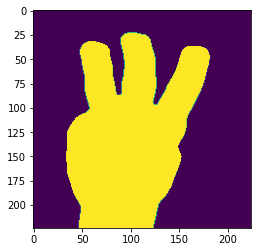

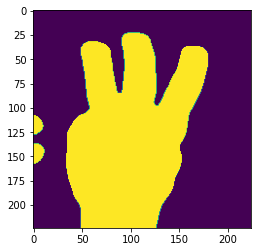

In [187]:
# Preprocess images from Renamed Dataset and save to Preprocessed Dataset
dataset_root = '/content/drive/MyDrive/Colab Notebooks/Datasets/OurDataset/Raw_Dataset_Renamed'
dataset_path = os.path.join(dataset_root, 'Letters')
for letter in letters:
  path_class = os.path.join(dataset_path, letter)
  path_class_dest = os.path.join(dataset_preprocessed, letter)
  for item in os.listdir(path_class):
    img = cv2.imread(os.path.join(path_class, item))
    img = skin_segmentation(img)
    cv2.imwrite(os.path.join(path_class_dest, item), img)